### Import Libraries


In [3]:
import numpy as np
from scipy.io import wavfile
import librosa
from IPython.display import Audio 
%matplotlib inline
import matplotlib.pyplot as plt
from ipywidgets import interact, interactive
import ipywidgets as widgets
import librosa.display
import warnings; warnings.filterwarnings("ignore")
import IPython
from IPython.display import HTML
from base64 import b64encode
!pip install gdown
!apt-get install sox

Reading package lists... Done
Building dependency tree       
Reading state information... Done
sox is already the newest version (14.4.2-3ubuntu0.18.04.1).
0 upgraded, 0 newly installed, 0 to remove and 10 not upgraded.


# Audio Formats
Audio is recorded using microphones. Read about different types of microphones and their applications [here](https://blog.landr.com/microphone-types/).


Audio can be stored digitally in a variety of formats, depending on application. 

**Uncompressed** formats are used to preserve the audio quality but take up a large amount of space (10MB/minute). 

e.g - WAV (Windows), AIFF (macOS)

**Compressed** formats are lossy in their compression - typically use *perceptual coding* to achieve a compression of upto 10x

e.g - MP3, AAC, OGG

Read more about audio formats [here](https://soundbridge.io/audio-formats-file-types/).



###Audio Terminology

**Codec** - Compression standard used to effectively stream audio at a low bit-rate. e.g - mp3, aac, wav. Read more [here](https://www.dacast.com/blog/best-audio-codec/).


**Sampling Rate** - Number of samples per second. Standard sampling rate on CDs is 44.1kHz (44,100 values to encode every second of audio!). Read more about [Nyquist-sampling](https://www.musictech.net/guides/essential-guide/science-of-signal-sampling/) in audio.

**Channels** - Independent microphones/speakers used for audio recording/playback. \\
Commonly,
> **Surround-sound** (5.1) - 5 channels (front/back and left/right surrounding) + 1 low-frequency effects \\
> **Stereo** - Two-channel audio with left-right directionality \\
> **Mono** - Single channel audio



---

Reading Exercise: What is the LFE channel in surround-sound and why is it needed?

---



**Bit Depth** - Number of bits used to encode audio signal amplitude.

**Bit Rate** - Audio stream quality measured in bits/sec used to encode the audio.

> bit-rate = sampling-rate \* channels \* bit-depth

Some common bit-rates: \\
CD (PCM): 1440 Kbps \\
mp3 : 128-320 Kbps \\


<p align="center">
<img src="https://drive.google.com/uc?id=1QaZXtDRhCdklQLxpoVQFVmrrDDpHTg2P" width="500">
</p>
<p align="center"><sub>Image borrowed from <a href="https://www.izotope.com/en/learn/digital-audio-basics-sample-rate-and-bit-depth.html">external source</a></sub>
</p>



**Additional Reference** - [Audio Formats](https://soundbridge.io/audio-formats-file-types/), [Sampling and Bit-Rate](https://www.headphonesty.com/2019/07/sample-rate-bit-depth-bit-rate/)


## FFMPEG Returns!
Extracting audio stream from video content

In [4]:
!gdown --id "1Zkkv2kT7YK8Z-3VuBCqDGlJMwL9CbBOE" --output movie_sample.mp4

## ffprobe - ffmpeg helper command to list details 
!ffprobe movie_sample.mp4 2>&1 | grep "Audio"

## Extract audio stream from mp4 file
!ffmpeg -loglevel error -i movie_sample.mp4 -acodec pcm_s16le movie_sample.wav


Downloading...
From: https://drive.google.com/uc?id=1Zkkv2kT7YK8Z-3VuBCqDGlJMwL9CbBOE
To: /content/movie_sample.mp4
68.3MB [00:00, 121MB/s] 
    Stream #0:1(und): Audio: aac (LC) (mp4a / 0x6134706D), 48000 Hz, 5.1, fltp, 383 kb/s (default)


###Mix down from 5.1 Surround Sound to Stereo and Mono

<img src="https://drive.google.com/uc?id=1jwhNPDWe_XkhjHpy5PbcYOlzPKaUO3EK">
<img src="https://drive.google.com/uc?id=1PYsvg74V9R_Np0nKjntR31yPOgF_60f9">


**Reference** - [Audio Channel Manipulation](https://trac.ffmpeg.org/wiki/AudioChannelManipulation)


Notice the difference between stereo and mono

###Stereo

In [5]:
!ffmpeg -loglevel error -i movie_sample.mp4 -acodec pcm_s16le -ar 16000 -ac 2 movie_sample-stereo_down.wav
## -acodec - audio codec in output stream
## -ar - sample frequency in output
## -ac - number of channels in output
Audio('movie_sample-stereo_down.wav', rate=16000)

### Mono

In [6]:
!ffmpeg -loglevel error -i movie_sample.mp4 -acodec pcm_s16le -ar 16000 -ac 1 movie_sample-mono_down.wav
Audio('movie_sample-mono_down.wav', rate=16000)

###Trim the audio file

In [7]:
!ffmpeg -loglevel error -i movie_sample.mp4 -acodec pcm_s16le -ar 16000 -ac 1 -ss 00:00:23 -to 00:00:25.8 movie_sample_trimmed.wav
Audio('movie_sample_trimmed.wav', rate=16000)

## SoX - Open-Source CLI Software for Audio Manipulation

Follow this [tutorial](http://billposer.org/Linguistics/Computation/SoxTutorial.html) to learn useful sox commands and also this [blog post](https://madskjeldgaard.dk/posts/sox-tutorial-split-by-silence/) to try out some cool things you can do with sox

In [8]:
!soxi movie_sample.wav
#sox movie_sample.wav -r 16000 movie_sample_16k-sox.wav ## Resample 
#sox movie_sample.wav -c 2 movie_sample_stereo-sox.wav  ## Downmix to stereo
#sox movie_sample.wav movie_sample_trimmed-sox.wav trim 23 =25.8   # Trim audio file 


Input File     : 'movie_sample.wav'
Channels       : 6
Sample Rate    : 48000
Precision      : 16-bit
Duration       : 00:02:44.22 = 7882752 samples ~ 12316.8 CDDA sectors
File Size      : 94.6M
Bit Rate       : 4.61M
Sample Encoding: 16-bit Signed Integer PCM





---


#Speech Production



In [9]:
span_url = "https://drive.google.com/uc?id=1A0xRuA4knZkpUFwy3zIbMhx8jh6DtfQA"
HTML("""<video width=400 controls><source src="%s" type="video/mp4"></video>""" % span_url)

Watch this interesting [talk](https://www.clsp.jhu.edu/events/measuring-and-using-speech-production-information-shri-narayanan-viterbi-school-of-engineeringuniversity-of-southern-california/#.YC1X7RNKgUE) given by Prof. Shri Narayanan on speech production

## Articulatory organs involved in human speech production
<p align="center">
<img src="https://drive.google.com/uc?id=1NnCr2az6k2LiItuxYcKFNqbGR1lsjYgL"/>
</p>
<p align="center"><sub>Image borrowed from <a href="http://www.literary-articles.com/2012/03/mechanism-of-speech-process-and.html">external source</a></sub>
</p>

### Source-filter model 
  The human speech apparatus can be modeled as a Linear Time-Invariant ([LTI](https://brilliant.org/wiki/linear-time-invariant-systems/)) system:
 1. Source: Input acoustic energy generated in the larynx

      *   Voicing source - Series of impulses caused by vocal-fold vibrations in the larynx
      *   Unvoiced/Noise source - Air turbulence caused by constriction of glottis (aspiration) and obstruction in the vocal tract (frication)

 2. Filter: Vocal tract acts as a filter, modifying the source signal - allowing certain frequencies to pass through and attenuating others

<p align="center"><img src="https://drive.google.com/uc?id=1lzok3ID33-XAhLAJ-TZaEm8Y9-RaCqjM" width="500" /> </p>

Read about speech production in detail in this [slide-deck](https://ocw.mit.edu/courses/linguistics-and-philosophy/24-915-linguistic-phonetics-fall-2015/lecture-notes/MIT24_915F15_lec4.pdf)

In [42]:
%%html
<iframe src="https://sail.usc.edu/span/rtmri_ipa/db_2015.html" width="1200" height="600"></iframe>

# Audio Representations
## Time Domain






In [11]:
# download and load .wav file
#!wget http://www.voiptroubleshooter.com/open_speech/american/OSR_us_000_0010_8k.wav
#!gdown --id 1DdZqW9iWpReSGUBXXaiZVAGLNF-tZpvg --output speech_sample.wav
speech, srate = librosa.load('movie_sample_trimmed.wav', 16000)
print(srate)
Audio(speech, rate=srate)


16000


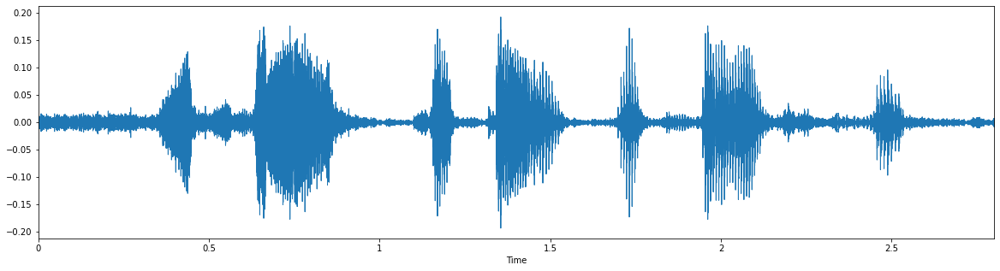

In [12]:
# plot .wav file
plt.figure(figsize=(20,5))
librosa.display.waveplot(speech, sr=srate)
# memory req to store time-domain representation


## Time-Frequency - Spectrograms

Spectrograms are 2D (time-frequency) representations of an audio signal that plot the distribution of different frequency components of the time-windowed versions of the audio.
<p align="center">
  <img src="https://drive.google.com/uc?id=1ph1sMmSbFWr_PBY-6cP_LOJJpciOgOPh" width="600"/> 
</p>

<p align="right"><sub>Image borrowed from <a href="https://source-separation.github.io/tutorial/basics/representations.html">external source</a></sub>
</p>
<br><br>

The short-time fourier transform (STFT) - denoted as $X[f, n]$ can be written as

\begin{equation}
X[f, n] = \sum_{k = n}^{n+N-1} x[k] \, w[k-n] \;  \mathrm{e}^{-\mathrm{j}\frac{2 \pi}{N} k f}
\end{equation}

where, x[n] is the audio signal and w[n] is the window function 



**Reference** - [Fourier Transform](https://www.youtube.com/watch?v=spUNpyF58BY&ab_channel=3Blue1Brown)

For audio signals, the spectrogram  S is the (log) magnitude of the STFT of the raw audio signal

\begin{equation}
S[f, n] = 20\log_{10}|X[f, n]| \hspace{1em}   (dB)
\end{equation}


**Reference** - [STFT and the Spectrogram](https://www.youtube.com/watch?v=NA0TwPsECUQ&ab_channel=BarryVanVeen)







In [16]:
## Helper function to plot spectrogram
def plot_spectrogram(aud, rate, type='narrowband'):
  if type=='narrowband':
    win_length = rate // 40
    hop_length = rate // 100
  else:
    win_length = rate // 400
    hop_length = rate // 1000
  # compute stft
  stft = np.abs(librosa.stft(aud, win_length=win_length, hop_length=hop_length))
  print(stft.shape)
  stft_db = librosa.amplitude_to_db(stft)
  # plot stft
  plt.figure(figsize=(20,5))
  plt.title("Spectrogram")
  librosa.display.specshow(stft_db, sr=rate, x_axis='time', y_axis='hz', cmap='viridis')
  plt.colorbar(format='%+2.0f dB')


### Speech Spectrogram

Formants: Concentration of energy around a range of frequencies in the wideband spectrogram

---



---

Reading Exercise: Formant structures, wideband vs narrowband spectrograms, Reading Spectrograms



---



---


**References** - [Formant Structures](https://home.cc.umanitoba.ca/~krussll/phonetics/acoustic/spectrogram-sounds.html), [Narrow- vs Wide-band Spectrograms](https://homepages.wmich.edu/~hillenbr/501/NBvsBBGrams.pdf), [Reading Spectrograms](https://www.youtube.com/watch?v=mWel5j-F8lE&list=PLRIMXVU7SGRJu1hMMfINC585iHd8iXJnv&ab_channel=TheVirtualLinguisticsCampus)

### Narrowband spectrogram

(1025, 281)


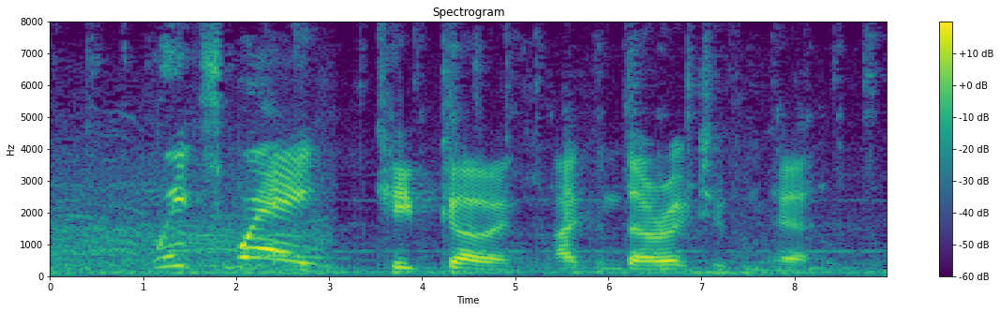

In [17]:
plot_spectrogram(speech, rate=srate)

### Wideband Spectrogram 

(1025, 2801)


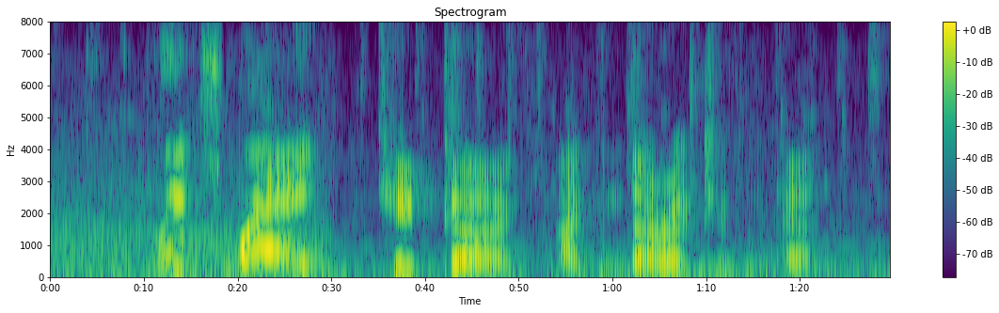

In [18]:
plot_spectrogram(speech, rate=srate, type='wideband')

---



### A few musical instruments through the lens of spectrograms

In [19]:
!wget https://philharmonia-assets.s3-eu-west-1.amazonaws.com/uploads/2020/02/12112005/all-samples.zip
!unzip -q all-samples.zip
!unzip -q all-samples/flute.zip -d flute && unzip -q all-samples/violin.zip -d violin && unzip -q all-samples/double\ bass.zip -d dbass

--2021-02-18 00:27:26--  https://philharmonia-assets.s3-eu-west-1.amazonaws.com/uploads/2020/02/12112005/all-samples.zip
Resolving philharmonia-assets.s3-eu-west-1.amazonaws.com (philharmonia-assets.s3-eu-west-1.amazonaws.com)... 52.218.96.131
Connecting to philharmonia-assets.s3-eu-west-1.amazonaws.com (philharmonia-assets.s3-eu-west-1.amazonaws.com)|52.218.96.131|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 260849422 (249M) [application/zip]
Saving to: ‘all-samples.zip’

all-samples.zip     100%[===================>] 248.76M  30.3MB/s    in 8.9s    

2021-02-18 00:27:35 (27.9 MB/s) - ‘all-samples.zip’ saved [260849422/260849422]



(1025, 139)


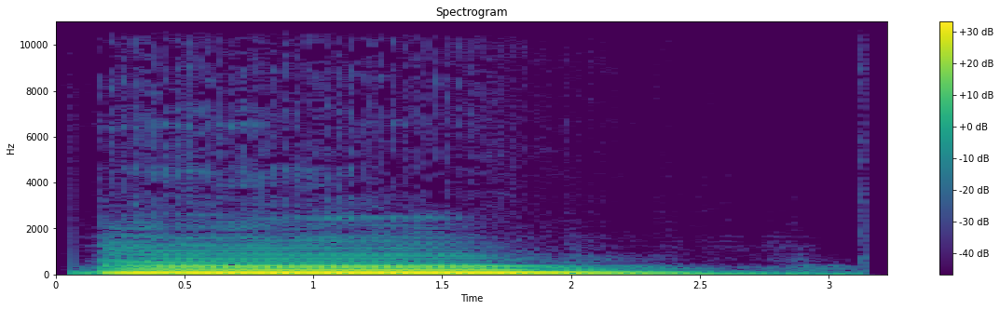

In [21]:
bass, r = librosa.load('dbass/double-bass_A1_1_forte_arco-normal.mp3')
plot_spectrogram(bass, r)
Audio(bass, rate=r)

(1025, 163)


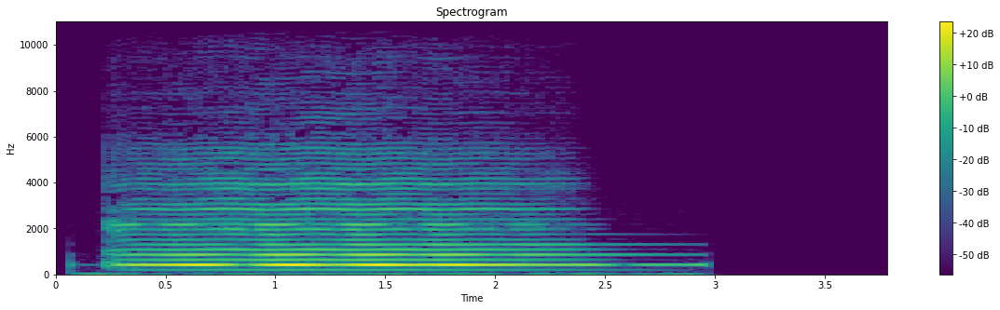

In [22]:
violin, r = librosa.load('violin/violin_A3_1_forte_arco-normal.mp3')
plot_spectrogram(violin, r)
Audio(violin, rate=r)

(1025, 108)


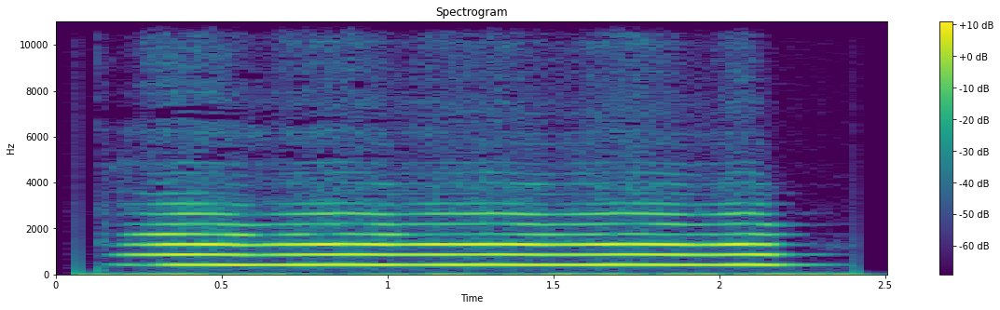

In [23]:
flute, r = librosa.load('flute/flute_A4_1_forte_normal.mp3')
plot_spectrogram(flute, r)
Audio(flute, rate=r)

## Mel Spectrogram
Human hearing is more discriminative at lower frequencies and less discriminative at higher frequencies. In other words, a change in frequency at low-frequency range (&lt;2K Hz) is much more **easily perceived** than the same change at a high-frequency range (&gt;6K Hz)

The Mel-scale mimics this behaviour by rescaling frequency bins such that they are at equal increments perceptually.

We can convert between Hertz (f) and Mel (m) using the following equations:
\begin{equation}
  m = 2595\log_{10}\left(1 + \frac{f}{700}\right) \hspace{1em} (mels) \\
  f = 700\left(10^{m/2595} - 1\right) \hspace{1em} (Hz)
\end{equation}

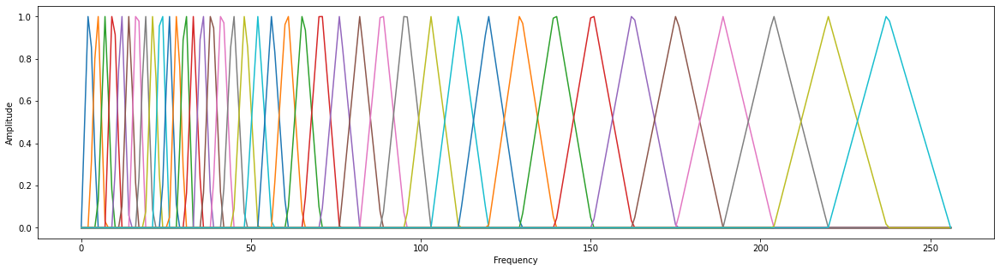

In [24]:
mels = librosa.filters.mel(sr=16000,  n_fft=512, n_mels=40,fmin=0, fmax=8000)
mels /= np.max(mels, axis=-1)[:, None]
plt.figure(figsize=(20,5))
plt.plot(mels.T)
plt.xlabel('Frequency');plt.ylabel('Amplitude')
plt.show()

(64, 281)


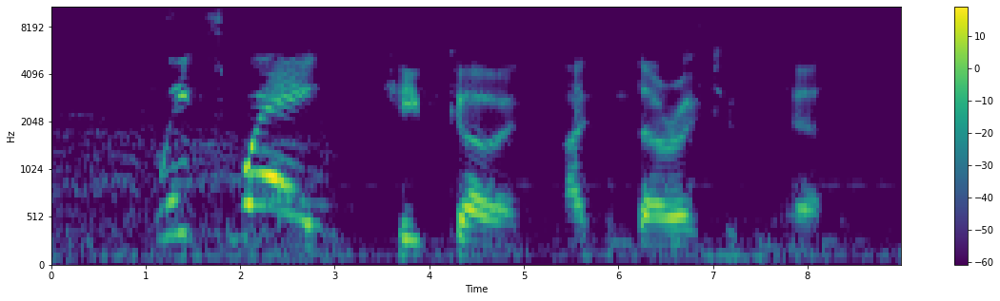

In [25]:
mel_stft = librosa.feature.melspectrogram(speech, sr=srate, n_mels=64, win_length=srate//40, hop_length=srate//100)
mel_stft_db = librosa.amplitude_to_db(np.abs(mel_stft))
print(mel_stft.shape)
# plot stft
plt.figure(figsize=(20,5))
librosa.display.specshow(mel_stft_db, sr=srate, x_axis='time', y_axis='mel', cmap='viridis')
plt.colorbar();

#aud_recon_mel = librosa.feature.inverse.mel_to_audio(mel_stft, sr=rate)


##Mel-Frequency Cepstral Coefficients (MFCC)

Mel filterbanks can be further compressed by applying Discrete Cosine Transform (similar to JPEG compression). DCT helps further decorrelate  mel-filterbanks, retaining as much information as possible in a handful (typically 12-40) of "cepstral" coefficients, known as MFCCs.

<p align="center">
  <img src="https://drive.google.com/uc?id=1An8Bc5B_CHA2Smp278kD7A6ldh-_c_Mz" width="600"/> 
</p>
<br><br>


(20, 281)


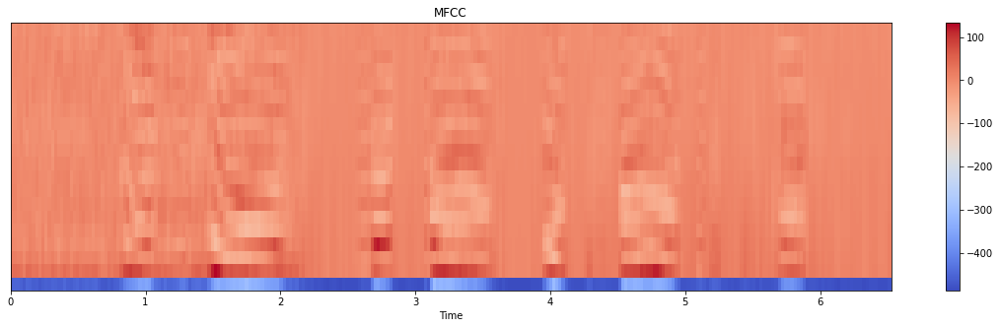

In [26]:
mfcc = librosa.feature.mfcc(S=mel_stft_db, win_length=srate//40, hop_length=srate//100)
print(mfcc.shape)
plt.figure(figsize=(20,5));plt.title("MFCC")
librosa.display.specshow(mfcc, x_axis='time')
plt.colorbar();

##Comparing effectiveness of different representations via Audio reconstruction quality
### Spectrogram  --> Audio

(1025, 279)


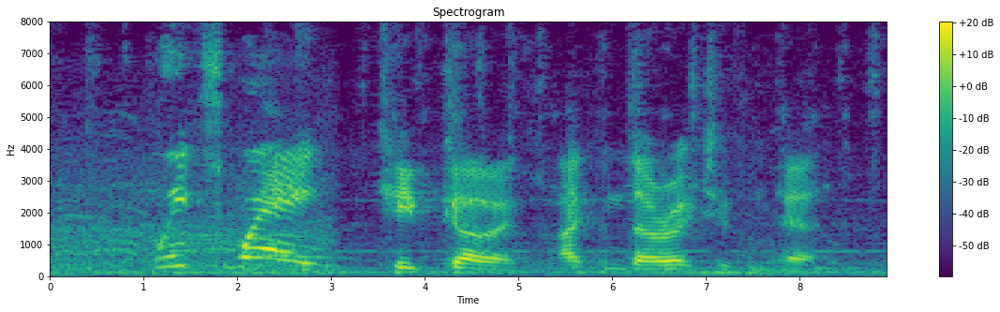

In [27]:
# reconstruct audio from magnitude spectrum
stft = np.abs(librosa.stft(speech))
aud_recon_stft = librosa.griffinlim(stft)
plot_spectrogram(aud_recon_stft, rate=srate)
Audio(aud_recon_stft, rate=srate)

### Mel-Spectrogram --> Audio

(1025, 281)


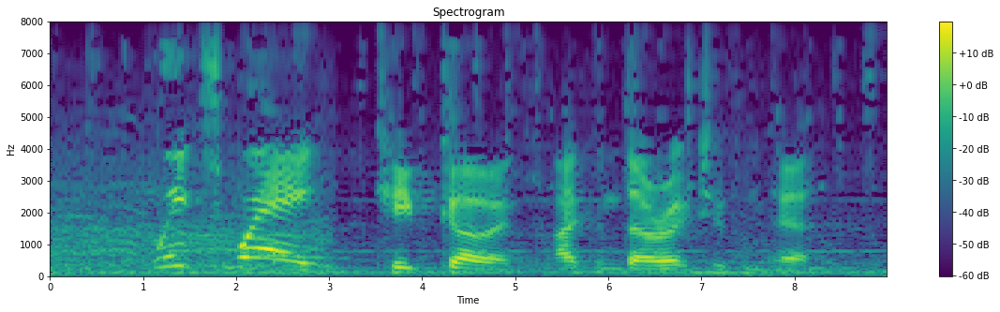

In [28]:
aud_recon_mel = librosa.feature.inverse.mel_to_audio(np.abs(mel_stft), sr=srate, win_length=srate//40, hop_length=srate//100)
plot_spectrogram(aud_recon_mel, rate=srate)
Audio(aud_recon_mel, rate=srate)


###MFCC --> Audio

(1025, 281)


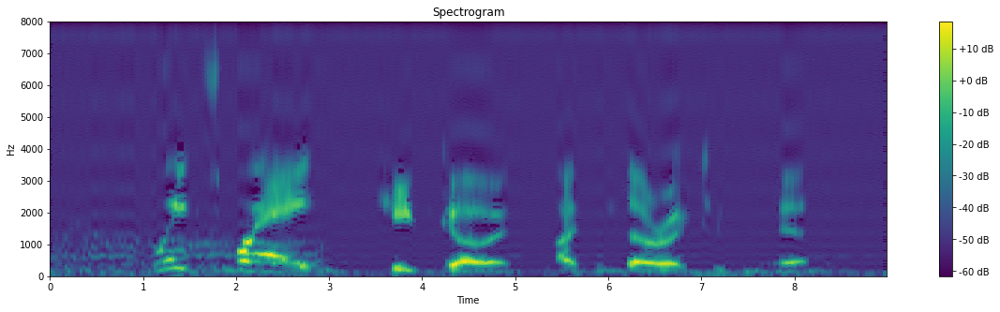

In [29]:
aud_recon_mfcc = librosa.feature.inverse.mfcc_to_audio(mfcc, n_mels=64, win_length=srate//40, hop_length=srate//100)
plot_spectrogram(aud_recon_mfcc, rate=srate)
Audio(aud_recon_mfcc, rate=srate)

## Time-Frequency Representation - Takeaways!

1. Spectrogram is a compact and easily interpretable representation of an audio signal 
2. Perceptually motivated compression techniques can be used to compress spectrograms -> Mel-spectrograms and MFCC
3. Tradeoff between memory and "quality" of representation. 




---


# Audio Augmentation

1. Adding noise to signal
2. Time-Frequency Scaling
3. Reverberation?




###1. Noise Augmentation

Signal to Noise Ratio is the ratio of the power of signal (speech) to the power of noise (non-speech) in a mixed signal.

\begin{equation}
\text{SNR}_{dB} = 10 \log_{10}\left(\dfrac{P_{signal}}{P_{noise}}\right)
\end{equation}

To augment noise to signal at a specific SNR, we can estimate the noise-scaling coefficient as 
\begin{equation}
 k_{n} = \left(\dfrac{P_{signal}}{P_{noise}}\right) 10^{-SNR/10} 
\end{equation}
such that
\begin{equation}
  A_{noisy} = A_{signal} + \sqrt{k}_{n} A_{noise}
\end{equation}

where $A_{signal}$, $A_{noise}$ and $A_{noisy}$ denote the amplitudes of the clean speech, noise and noise-corrupted speech signals respectively

In [30]:
def generate_noisy_signal(signal, noise, snr):
  N = len(signal)
  noise = np.resize(noise, N)

  signal_power = np.sum(signal*signal)/N
  noise_power = np.sum(noise*noise)/N

  k = (signal_power/noise_power)*np.power(10, (-snr/10))
  scaled_noise = np.sqrt(k)*noise

  noisy_signal = signal + scaled_noise
  return noisy_signal

In [38]:
@interact(SNR=widgets.IntSlider(min=-30, max=30, step=5, value=10))
def simulate_aug(SNR):
  noisy = generate_noisy_signal(speech, bass, SNR)
  plot_spectrogram(noisy, rate = srate)
  display(Audio(noisy, rate=srate))
  

interactive(children=(IntSlider(value=10, description='SNR', max=30, min=-30, step=5), Output()), _dom_classes…



---


---
Exercise: Can you trim the bike sound at the beginning of the skyfall clip and augment the speech segment with it at different SNR levels?



---



---




2. Time-Frequency Scaling


>   a)   Time-scaling (Tempo)














In [39]:
@interact(Speed=widgets.FloatSlider(min=0.5, max=2, step=0.1, value=1))
def time_scale(Speed):
  signal_time_scaled = librosa.effects.time_stretch(speech.astype('float64'), Speed)
  plot_spectrogram(signal_time_scaled, rate=srate)
  display(Audio(signal_time_scaled, rate=srate))


interactive(children=(FloatSlider(value=1.0, description='Speed', max=2.0, min=0.5), Output()), _dom_classes=(…

> b) Frequency-scaling (Pitch)

In [40]:
@interact(Pitch=widgets.IntSlider(min=-10, max=10, step=2, value=5))
def pitch_scale(Pitch):
  signal_pitch_scaled = librosa.effects.pitch_shift(speech, sr=srate, n_steps=Pitch)
  plot_spectrogram(signal_pitch_scaled, rate=srate)
  display(Audio(signal_pitch_scaled, rate=srate))

interactive(children=(IntSlider(value=5, description='Pitch', max=10, min=-10, step=2), Output()), _dom_classe…

> c) Time and Frequency Scaling (Chipmunk effect)

In [41]:
@interact(Rate=widgets.FloatSlider(min=0.5, max=2, step=0.1, value=1.5))
def resample(Rate):
  resamp = np.interp(np.arange(0,len(speech),Rate),np.arange(0,len(speech)),speech)
  plot_spectrogram(resamp, rate=srate)
  display(Audio(resamp, rate=srate))

interactive(children=(FloatSlider(value=1.5, description='Rate', max=2.0, min=0.5), Output()), _dom_classes=('…



---

---





Exercise: Room impulse response, reverberation, reverberating non-reverberated speech



---



---

